In [1]:
import os
os.environ['CUDA_DEVICE_ORDER'] = 'PCI_BUS_ID'
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

In [2]:
import numpy as np
import pandas as pd

# import tqdm.notebook as tq
import tqdm as tq

import random

import torch
import torch.nn as nn

from torch.utils.data import Dataset, DataLoader

from sklearn.preprocessing import OneHotEncoder

import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = [30, 10]

In [3]:
random_seed = 13

torch.manual_seed(random_seed)
random.seed(random_seed)
np.random.seed(random_seed)

In [4]:
dataset = 'ElectricDevices'

from sktime.datasets import load_UCR_UEA_dataset

X_train, y_train = load_UCR_UEA_dataset(name=dataset, split='train', return_type='numpyflat')
X_test, y_test = load_UCR_UEA_dataset(name=dataset, split='test', return_type='numpyflat')

In [5]:
print(f'Length training data: {len(X_train)} labels: {len(y_train)} test data: {len(X_test)} labels: {len(y_test)}')

Length training data: 8926 labels: 8926 test data: 7711 labels: 7711


In [6]:
encoder = OneHotEncoder(categories='auto', sparse_output=False)

y_train_ohe = encoder.fit_transform(np.expand_dims(y_train, axis=-1))
y_test_ohe = encoder.transform(np.expand_dims(y_test, axis=-1))

y_train_norm = y_train_ohe.argmax(axis=-1)
y_test_norm = y_test_ohe.argmax(axis=-1)

In [7]:
class FordADataset(Dataset):

    def __init__(self, X, y):
        self.X = X
        self.y = y
    
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
        inputs = self.X[idx]
        label = self.y[idx]
        
        return inputs, label

In [8]:
dataset_train = FordADataset(X_train, y_train_ohe)
dataset_test = FordADataset(X_test, y_test_ohe)

In [9]:
dataloader_train = DataLoader(dataset_train, batch_size=120, shuffle=True)
dataloader_train_not_shuffled = DataLoader(dataset_train, batch_size=120, shuffle=False)
dataloader_test = DataLoader(dataset_test, batch_size=120, shuffle=False)

In [10]:
import torch
from torch import nn
import torch.nn.functional as F


class Conv1dSamePadding(nn.Conv1d):
    """Represents the "Same" padding functionality from Tensorflow.
    See: https://github.com/pytorch/pytorch/issues/3867
    Note that the padding argument in the initializer doesn't do anything now
    """
    def forward(self, input):
        kernel, dilation, stride = self.weight.size(2), self.dilation[0], self.stride[0]
        
        l_out = l_in = input.size(2)
    
        padding = (((l_out - 1) * stride) - l_in + (dilation * (kernel - 1)) + 1)
        if padding % 2 != 0:
            input = F.pad(input, [0, 1])

        return F.conv1d(input=input, weight=self.weight, bias=self.bias, stride=stride, padding=padding // 2, dilation=dilation, groups=self.groups)


class ResNetBlock(nn.Module):

    def __init__(self, in_channels, out_channels):
        super().__init__()

        channels = [in_channels, out_channels, out_channels, out_channels]
        kernel_sizes = [5, 3, 1]

        layers = []
        for i in range(len(kernel_sizes)):
            layers += [
                Conv1dSamePadding(in_channels=channels[i], out_channels=channels[i + 1], kernel_size=kernel_sizes[i], stride=1),
                nn.BatchNorm1d(num_features=channels[i + 1]),
                nn.ReLU(),
            ]
        self.layers = nn.Sequential(*layers)

        self.match_channels = False
        if in_channels != out_channels:
            self.match_channels = True
            self.residual = nn.Sequential(*[
                Conv1dSamePadding(in_channels=in_channels, out_channels=out_channels, kernel_size=1, stride=1),
                nn.BatchNorm1d(num_features=out_channels)
            ])

    def forward(self, x):
        if self.match_channels:
            return self.layers(x) + self.residual(x)
        return self.layers(x)


class ResNet(nn.Module):
    def __init__(self):
        super().__init__()
        
        num_pred_classes = 7
        in_channels = 1
        mid_channels = 10
        
        self.layers = nn.Sequential(*[
            ResNetBlock(in_channels=in_channels, out_channels=mid_channels),
            ResNetBlock(in_channels=mid_channels, out_channels=mid_channels * 2),
            ResNetBlock(in_channels=mid_channels * 2, out_channels=mid_channels * 2),

        ])
        self.fc = nn.Sequential(
            nn.Linear(mid_channels * 2, num_pred_classes),
            nn.Softmax(-1)
        )

        
    def forward(self, x):
        x = self.layers(x)
        x = x.mean(dim=-1)
        x = self.fc(x)
        
        return x

# Training of the model

In [11]:
def trainer(model, dataloader_train, criterion):
    running_loss = 0

    model.train()

    for idx, (inputs, labels) in enumerate(dataloader_train):
        inputs = inputs.reshape(inputs.shape[0], 1, -1)
        inputs = inputs.float().to(device)
        labels = labels.float().to(device)

        optimizer.zero_grad()
        preds = model(inputs)
        loss = criterion(preds, labels.argmax(dim=-1))
        loss.backward()
        optimizer.step()
        
        running_loss += loss.item()

    train_loss = running_loss / len(dataloader_train)
    
    return train_loss


def validator(model, dataloader_test, criterion):
    running_loss = 0

    model.eval()

    for idx, (inputs, labels) in enumerate(dataloader_test):
        inputs = inputs.reshape(inputs.shape[0], 1, -1)
        inputs = inputs.float().to(device)
        labels = labels.float().to(device)

        preds = model(inputs)
        loss = criterion(preds, labels.argmax(dim=-1))
        
        running_loss += loss.item()

    train_loss = running_loss / len(dataloader_train)
    
    return train_loss

In [12]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = ResNet().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
loss = nn.CrossEntropyLoss()

In [13]:
epochs = 500

for epoch in range(epochs):
    train_loss = trainer(model, dataloader_train, loss)
    if epoch % 10 == 0:
        print(f'Val {validator(model, dataloader_test, loss):}')
        print('Train', train_loss)

Val 1.6612206347783407
Train 1.929276696840922
Val 1.4639711491266887
Train 1.6357905642191568
Val 1.4363049141565958
Train 1.5878358030319213
Val 1.4263307110468546
Train 1.56476007938385
Val 1.4154001760482788
Train 1.5334087721506755
Val 1.3874178059895834
Train 1.4833962519963582
Val 1.3786907037099203
Train 1.4525899108250935
Val 1.3487206649780275
Train 1.4225574286778768
Val 1.3395806423823038
Train 1.4047566509246827
Val 1.342825140953064
Train 1.3915011803309123
Val 1.3314260800679525
Train 1.383422064781189
Val 1.3315919399261475
Train 1.378311227162679
Val 1.3244005552927653
Train 1.3725102202097574
Val 1.321399653752645
Train 1.3678283675511678
Val 1.3257960510253906
Train 1.3647520860036215
Val 1.3184190622965495
Train 1.3616980663935343
Val 1.309018096923828
Train 1.357494379679362
Val 1.3001265462239584
Train 1.347636383374532
Val 1.2916748476028443
Train 1.3345251655578614
Val 1.2829872496922812
Train 1.3250300518671672
Val 1.2877729352315266
Train 1.3195963795979817
Va

In [14]:
model.eval()

preds = []
labels = []
for x in dataloader_train_not_shuffled:
    input_, label_ = x
    input_ = input_.reshape(input_.shape[0], 1, -1)
    input_ = input_.float().to(device)
    label_ = label_.float().to(device)

    pred_ = model(input_)
    preds.extend(pred_)
    labels.extend(label_)

preds = torch.stack(preds)
labels = torch.stack(labels)
print('Prediction Accuracy Train', np.round((preds.argmax(dim=-1) == labels.argmax(dim=-1)).int().sum().float().item() / len(preds), 4))

y_train_pred = preds.cpu().detach().numpy().round(3)

Prediction Accuracy Train 0.9005


In [15]:
model.eval()

preds = []
labels = []
for x in dataloader_test:
    input_, label_ = x
    input_ = input_.reshape(input_.shape[0], 1, -1)
    input_ = input_.float().to(device)
    label_ = label_.float().to(device)

    pred_ = model(input_)
    preds.extend(pred_)
    labels.extend(label_)

preds = torch.stack(preds)
labels = torch.stack(labels)
print('Prediction Accuracy Test', np.round((preds.argmax(dim=-1) == labels.argmax(dim=-1)).int().sum().float().item() / len(preds), 4))

y_test_pred = preds.cpu().detach().numpy().round(3)

Prediction Accuracy Test 0.7242


# Save results as json

In [16]:
%load_ext autoreload
%autoreload 2

In [17]:
import exp_perturbation_analysis as exp_pa

import exp_stability_indicator as exp_si

import exp_plots as exp_pl

import scipy as sp

In [18]:
from captum.attr import GradientShap, DeepLiftShap, IntegratedGradients, ShapleyValueSampling, Saliency, DeepLift

In [19]:
import matplotlib as mpl

cmap = 'tab10'

In [20]:
attribution_measure = exp_si.attribution_stability_indicator
get_asi_for_dataset = exp_si.get_asi_for_dataset

In [21]:
sample_idx = 2
sample_ts_np, sample_l = dataloader_test.dataset[sample_idx]

sample, label = dataset_train[0]
shape = sample_ts_np.reshape(1, -1).shape

baselines = torch.from_numpy(np.array([dataset_test[torch.randint(len(dataset_test), (1,))][0] for _ in range(10)])).reshape(-1, *shape).float().to(device)



attribution_techniques = [
    ['Saliency', Saliency, {}],
    ['GradientShap', GradientShap, {'baselines': baselines}],
    
    ['DeepLift', DeepLift, {}],
    ['DeepLiftShap', DeepLiftShap, {'baselines': baselines}],
    
    ['IntegratedGradients', IntegratedGradients, {}],
    
#     ['ShapleyValueSampling', ShapleyValueSampling, {}],
]

for at in tq.tqdm(attribution_techniques):
    at_name, at_class, at_kwargs = at
    asi_core_tmp = attribution_measure(model, sample_ts_np, sample_l, at_class, at_kwargs, debug=True, weights=[0.5, 1, 0.5, 3], perturbation_fnc=exp_pa.ood_l)

  0%|          | 0/5 [00:00<?, ?it/s]/home/schlegel/.conda/captum/lib/python3.10/site-packages/captum/_utils/gradient.py:57: UserWarning: Input Tensor 0 did not already require gradients, required_grads has been set automatically.
  warnings.warn(
/home/schlegel/.conda/captum/lib/python3.10/site-packages/captum/attr/_core/deep_lift.py:304: UserWarning: Setting forward, backward hooks and attributes on non-linear
               activations. The hooks and attributes will be removed
            after the attribution is finished
  warnings.warn(
 60%|██████    | 3/5 [00:00<00:00, 21.90it/s]

XAI: Saliency
Original Pred:  [1.57000e-04 6.00000e-06 3.24000e-04 6.89566e-01 2.69000e-04 3.08742e-01
 9.36000e-04]
Perturbed Pred: [0. 0. 0. 0. 1. 0. 0.]

TS Correl: 0.7007697099297422
Att Correl: 0.5

Labels
TL  P1  Pd
 5   3   4

ASI
0.37026

XAI: GradientShap
Original Pred:  [1.57000e-04 6.00000e-06 3.24000e-04 6.89566e-01 2.69000e-04 3.08742e-01
 9.36000e-04]
Perturbed Pred: [0. 0. 0. 0. 1. 0. 0.]

TS Correl: 0.4120935563762008
Att Correl: 0.5

Labels
TL  P1  Pd
 5   3   4

ASI
0.34139

XAI: DeepLift
Original Pred:  [1.57000e-04 6.00000e-06 3.24000e-04 6.89566e-01 2.69000e-04 3.08742e-01
 9.36000e-04]
Perturbed Pred: [0. 0. 0. 0. 1. 0. 0.]

TS Correl: 0.9957515363601944
Att Correl: 0.2185533216424959

Labels
TL  P1  Pd
 5   3   4

ASI
0.23089

XAI: DeepLiftShap
Original Pred:  [1.57000e-04 6.00000e-06 3.24000e-04 6.89566e-01 2.69000e-04 3.08742e-01
 9.36000e-04]
Perturbed Pred: [0. 0. 0. 0. 1. 0. 0.]

TS Correl: 0.9958182556611357
Att Correl: 0.2881337305621821

Labels
TL  P1  Pd

100%|██████████| 5/5 [00:00<00:00, 19.66it/s]

XAI: IntegratedGradients
Original Pred:  [1.57000e-04 6.00000e-06 3.24000e-04 6.89566e-01 2.69000e-04 3.08742e-01
 9.36000e-04]
Perturbed Pred: [0. 0. 0. 0. 1. 0. 0.]

TS Correl: 0.996286826518665
Att Correl: 0.5

Labels
TL  P1  Pd
 5   3   4

ASI
0.39981



In [30]:
loader = dataloader_train_not_shuffled
ret_train = get_asi_for_dataset(loader, model, attribution_techniques, [0.5, 1, 0.5, 3], perturbation_fnc=exp_pa.delete_to_global_mean, seq_len=1)

100%|██████████| 8926/8926 [42:12<00:00,  3.52it/s]


In [31]:
loader = dataloader_test
ret_test = get_asi_for_dataset(loader, model, attribution_techniques, [0.5, 1, 0.5, 3], perturbation_fnc=exp_pa.delete_to_global_mean, seq_len=1)

100%|██████████| 7711/7711 [35:32<00:00,  3.62it/s]


In [32]:
generate_projections = exp_pl.generate_projections
generate_histogram = exp_pl.generate_histogram

Name: Saliency
ASI: 5726.833, Flips: 1002


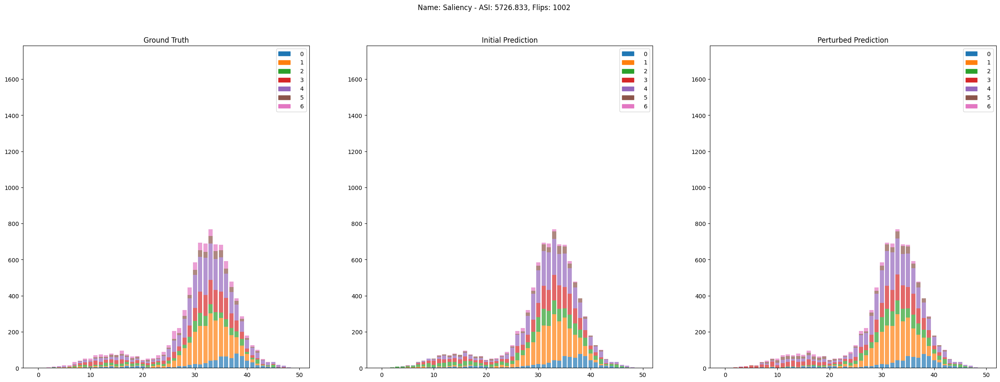

Name: GradientShap
ASI: 4560.936, Flips: 2798


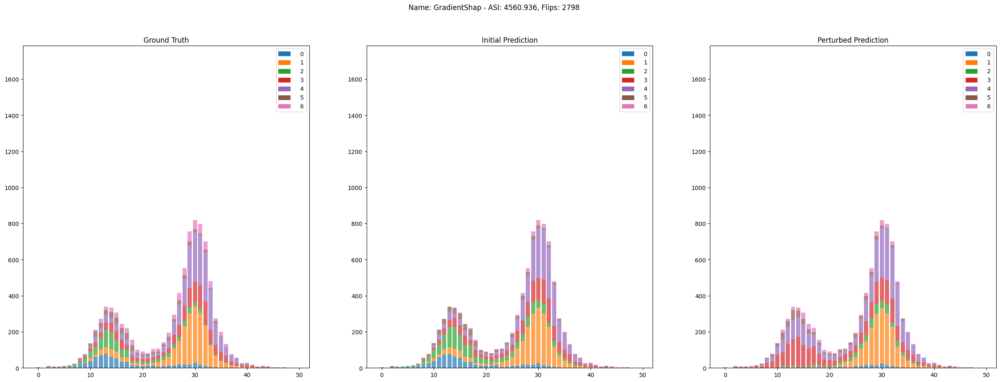

Name: DeepLift
ASI: 4761.529, Flips: 3764


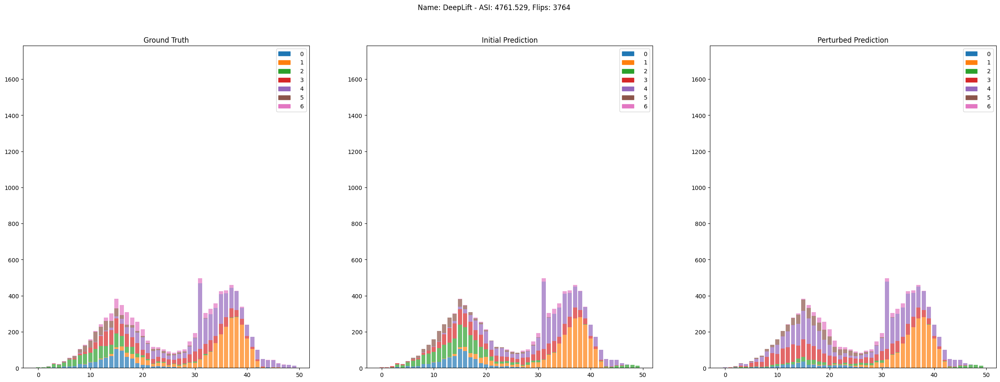

Name: DeepLiftShap
ASI: 4912.930, Flips: 3277


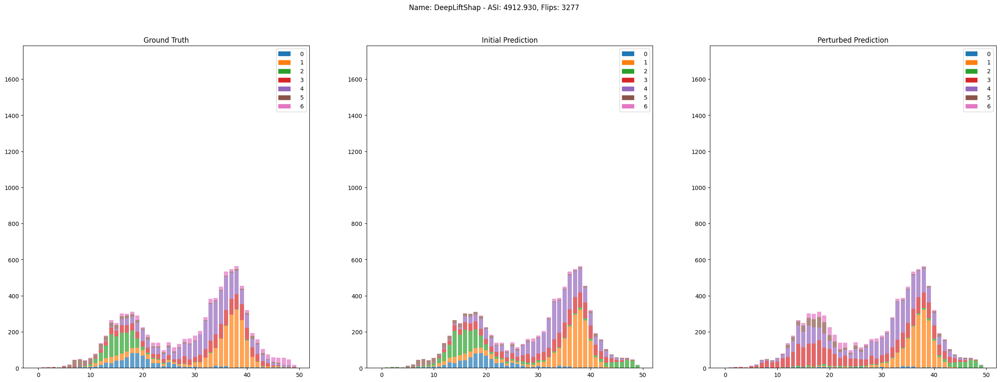

Name: IntegratedGradients
ASI: 4688.629, Flips: 3511


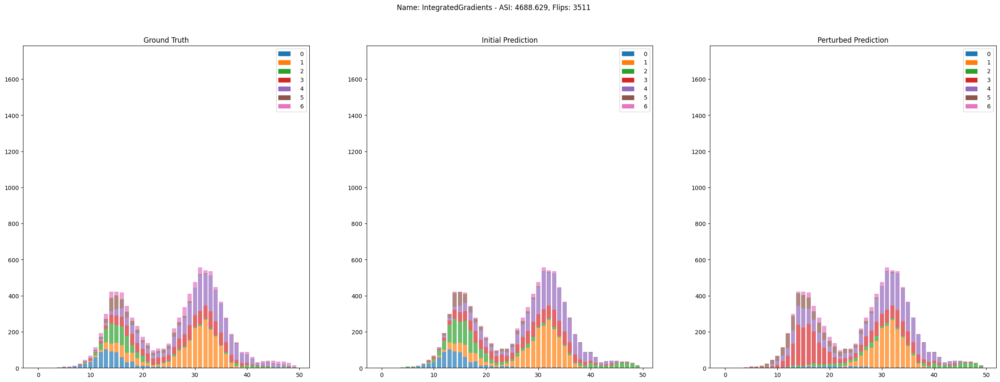

In [33]:
generate_histogram(ret_train)

Name: Saliency
ASI: 5726.833, Flips: 1002


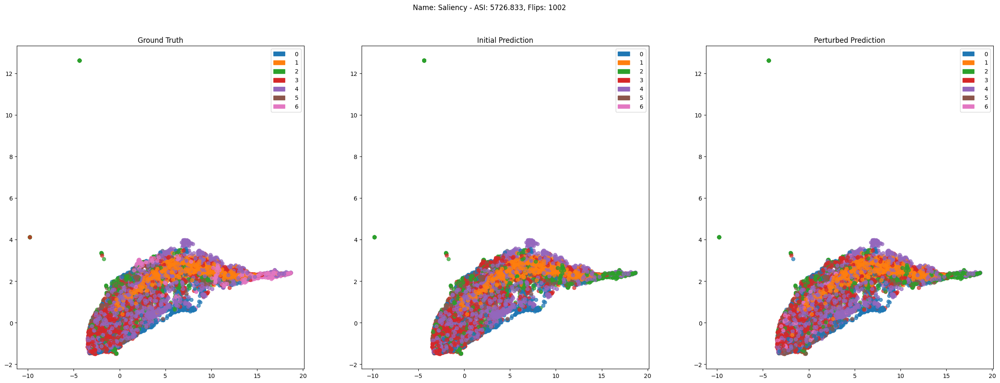

Name: GradientShap
ASI: 4560.936, Flips: 2798


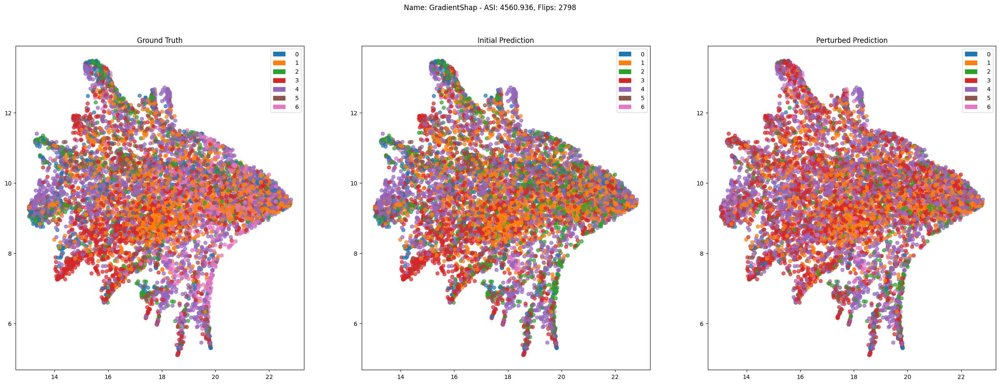

Name: DeepLift
ASI: 4761.529, Flips: 3764


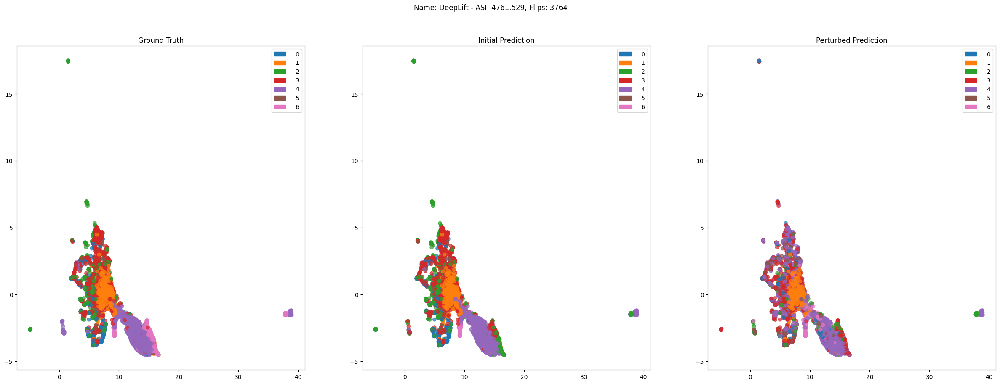

Name: DeepLiftShap
ASI: 4912.930, Flips: 3277


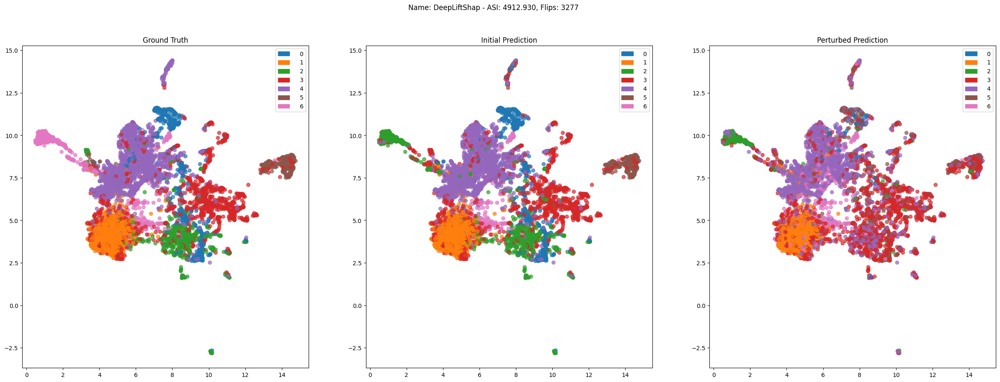

Name: IntegratedGradients
ASI: 4688.629, Flips: 3511


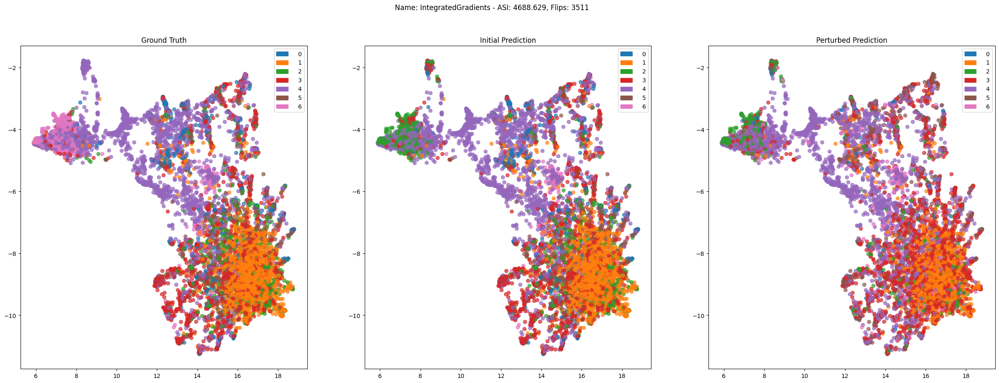

In [34]:
generate_projections(ret_train)

Name: Saliency
ASI: 4831.608, Flips: 1456


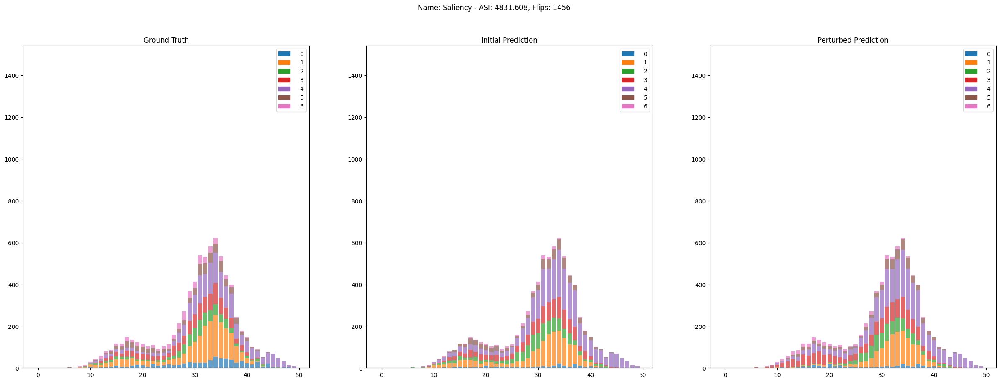

Name: GradientShap
ASI: 3851.680, Flips: 2875


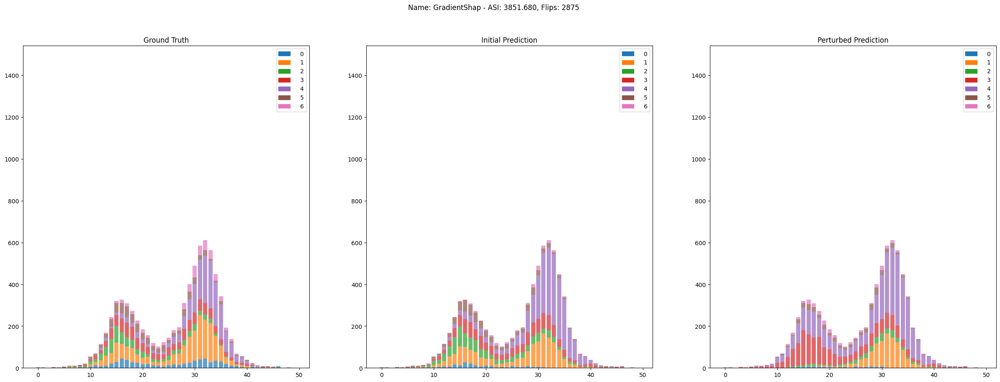

Name: DeepLift
ASI: 4019.183, Flips: 3533


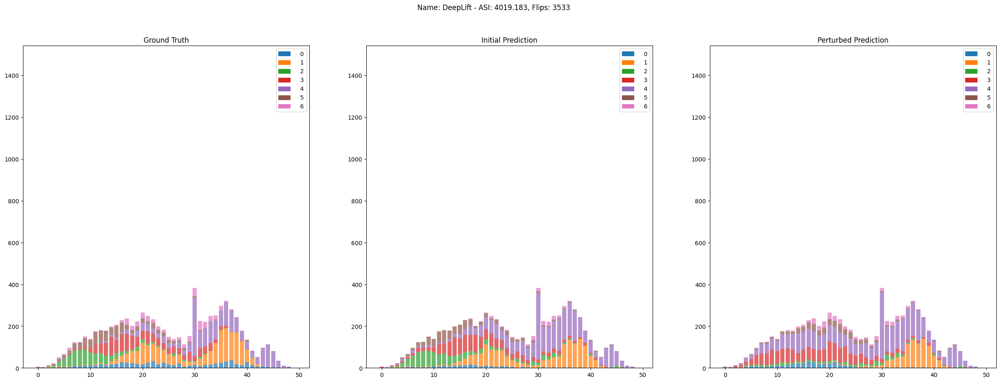

Name: DeepLiftShap
ASI: 4206.555, Flips: 3312


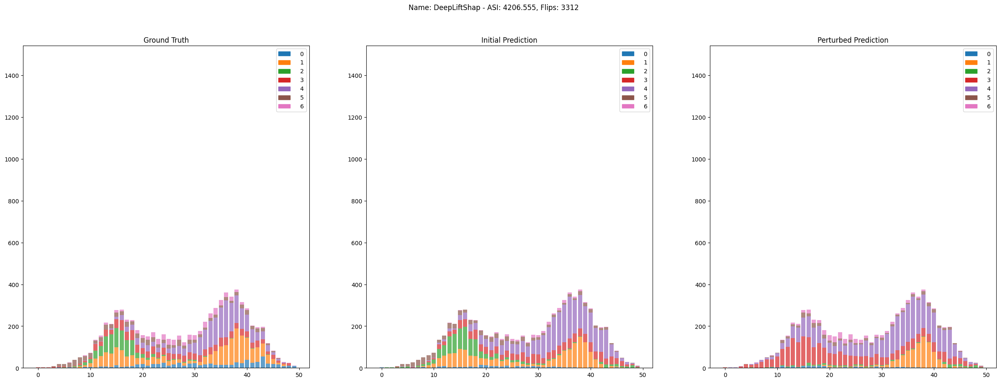

Name: IntegratedGradients
ASI: 4154.608, Flips: 3088


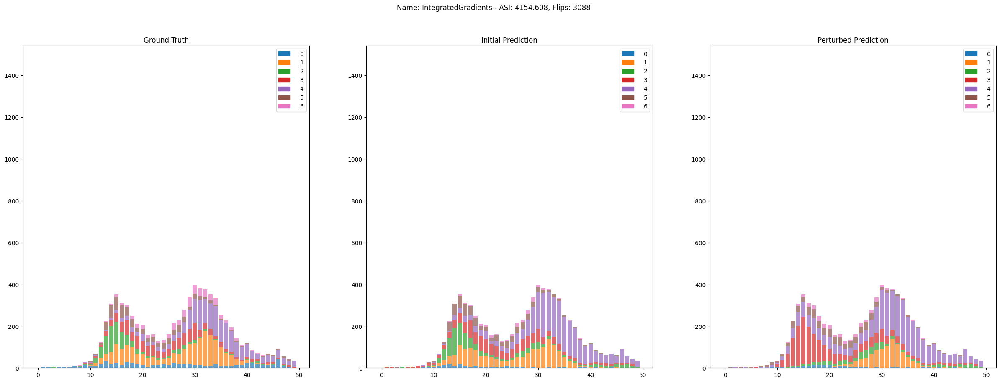

In [35]:
generate_histogram(ret_test)

Name: Saliency
ASI: 4831.608, Flips: 1456


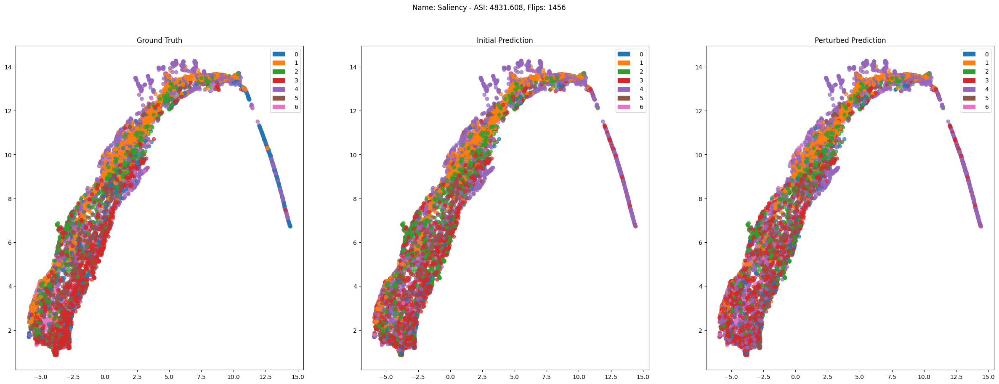

Name: GradientShap
ASI: 3851.680, Flips: 2875


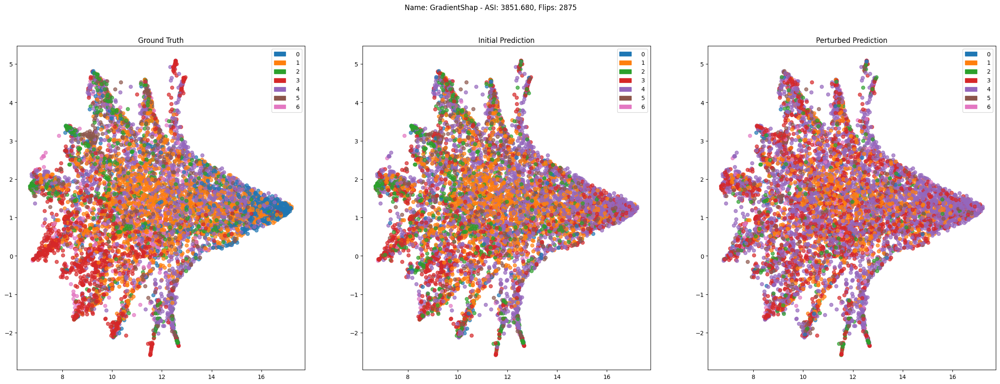

Name: DeepLift
ASI: 4019.183, Flips: 3533


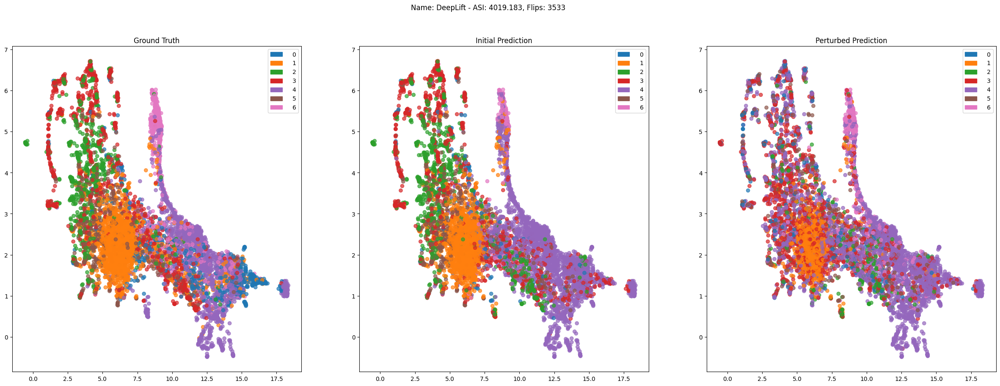

Name: DeepLiftShap
ASI: 4206.555, Flips: 3312


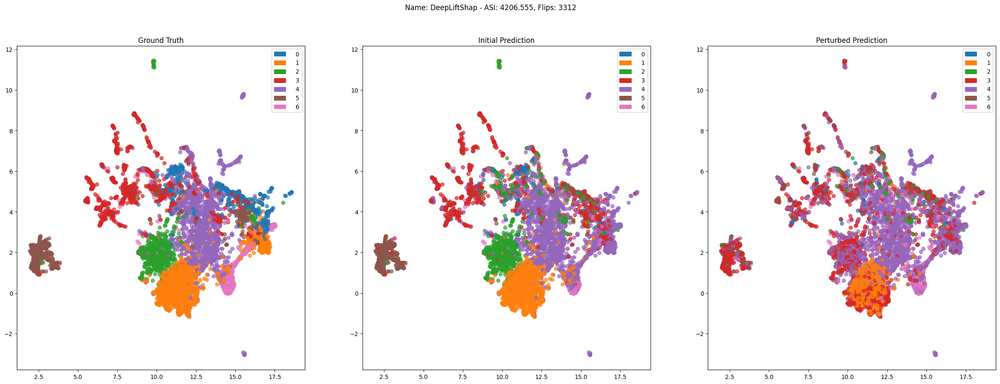

Name: IntegratedGradients
ASI: 4154.608, Flips: 3088


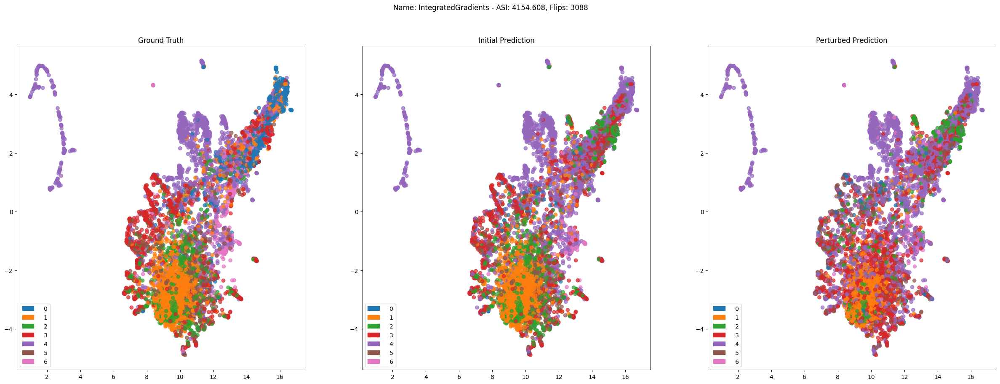

In [36]:
generate_projections(ret_test)

In [37]:
torch.save(model, 'models/electric-devices-resnet.pth')

In [38]:
loader = dataloader_train_not_shuffled
ret_train_w = get_asi_for_dataset(loader, model, attribution_techniques, [0.5, 1, 1, 2], perturbation_fnc=exp_pa.delete_to_global_mean, seq_len=1)

  0%|          | 0/8926 [00:00<?, ?it/s]/home/schlegel/.conda/captum/lib/python3.10/site-packages/captum/_utils/gradient.py:57: UserWarning: Input Tensor 0 did not already require gradients, required_grads has been set automatically.
  warnings.warn(
/home/schlegel/.conda/captum/lib/python3.10/site-packages/captum/attr/_core/deep_lift.py:304: UserWarning: Setting forward, backward hooks and attributes on non-linear
               activations. The hooks and attributes will be removed
            after the attribution is finished
  warnings.warn(
 13%|█▎        | 1189/8926 [05:41<38:09,  3.38it/s]/home/schlegel/.conda/captum/lib/python3.10/site-packages/scipy/spatial/distance.py:1300: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(js / 2.0)
100%|██████████| 8926/8926 [40:53<00:00,  3.64it/s]


In [39]:
loader = dataloader_test
ret_test_w = get_asi_for_dataset(loader, model, attribution_techniques, [0.5, 1, 1, 2], perturbation_fnc=exp_pa.delete_to_global_mean, seq_len=1)

100%|██████████| 7711/7711 [33:30<00:00,  3.84it/s]


Name: Saliency
ASI: 5106.712, Flips: 1002, Accuracy before 0.9005, after 0.8214


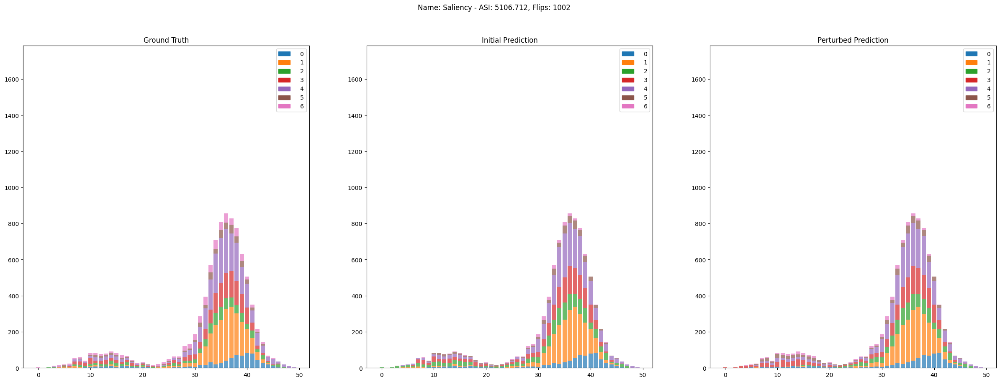

Name: GradientShap
ASI: 4155.515, Flips: 2794, Accuracy before 0.9005, after 0.6378


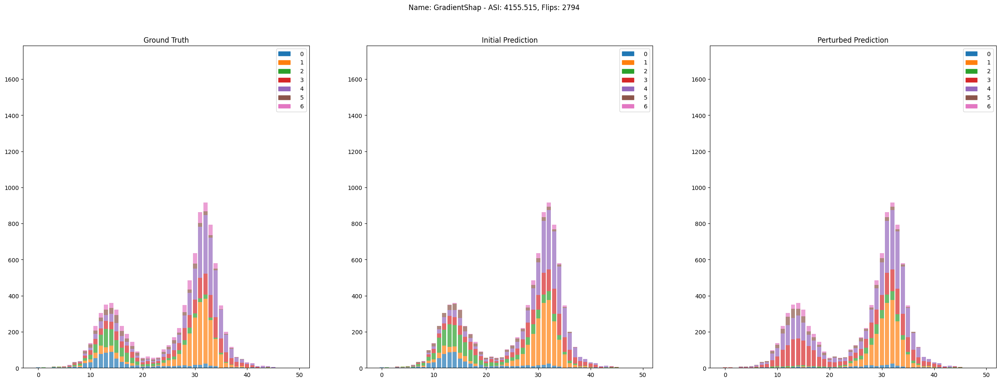

Name: DeepLift
ASI: 4232.832, Flips: 3764, Accuracy before 0.9005, after 0.5384


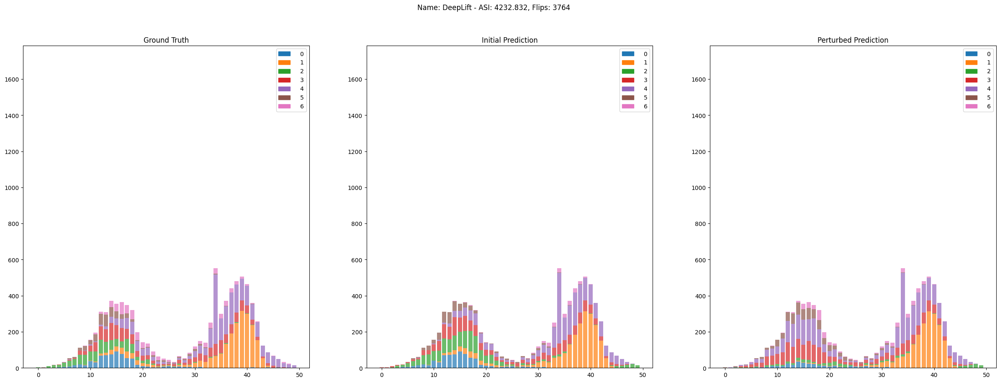

Name: DeepLiftShap
ASI: 4382.931, Flips: 3277, Accuracy before 0.9005, after 0.5783


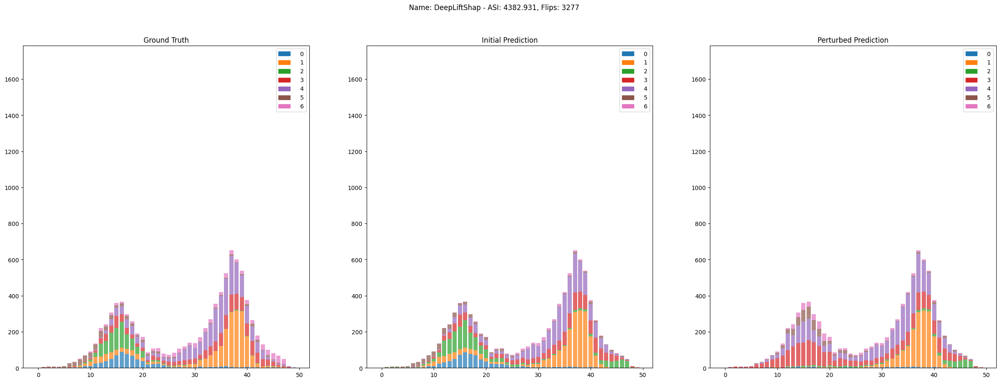

Name: IntegratedGradients
ASI: 4194.769, Flips: 3511, Accuracy before 0.9005, after 0.5553


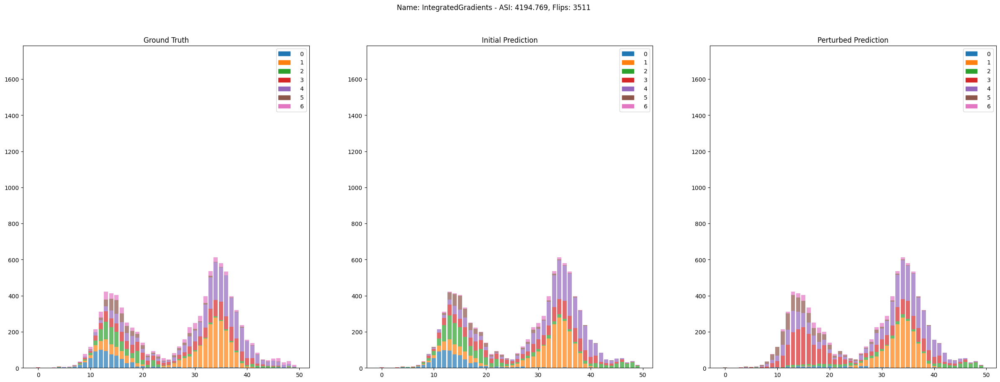

In [40]:
generate_histogram(ret_train_w)

Name: Saliency
ASI: 5106.712, Flips: 1002


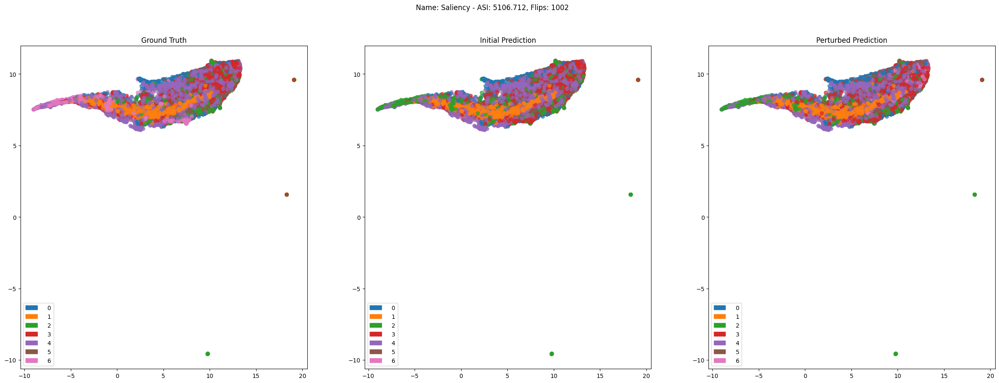

Name: GradientShap
ASI: 4155.515, Flips: 2794


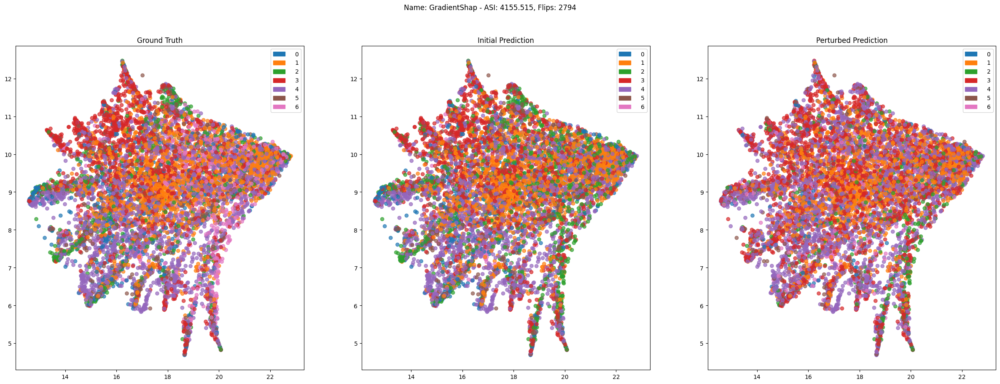

Name: DeepLift
ASI: 4232.832, Flips: 3764


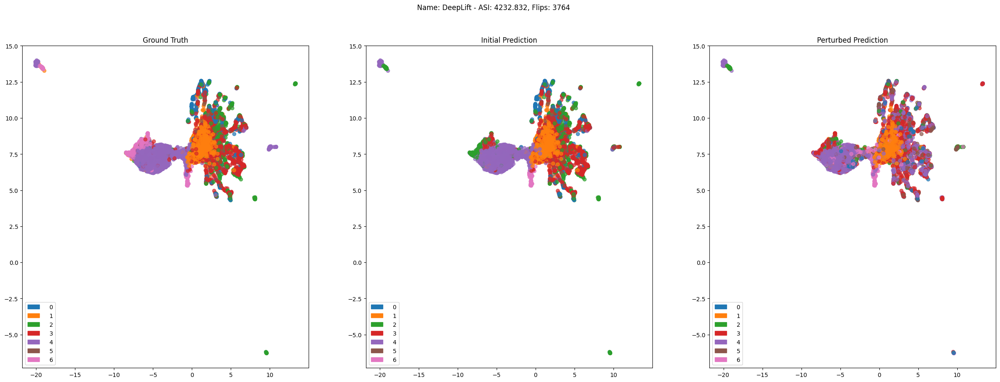

Name: DeepLiftShap
ASI: 4382.931, Flips: 3277


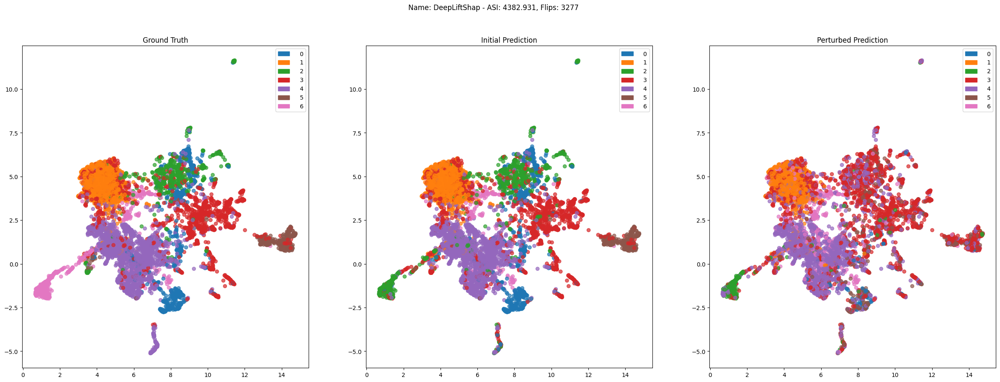

Name: IntegratedGradients
ASI: 4194.769, Flips: 3511


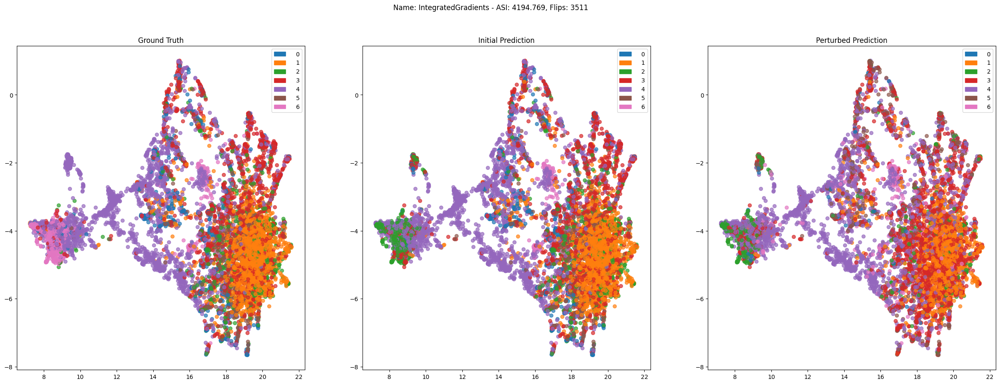

In [41]:
generate_projections(ret_train_w)

Name: Saliency
ASI: 4264.572, Flips: 1456, Accuracy before 0.7242, after 0.6247


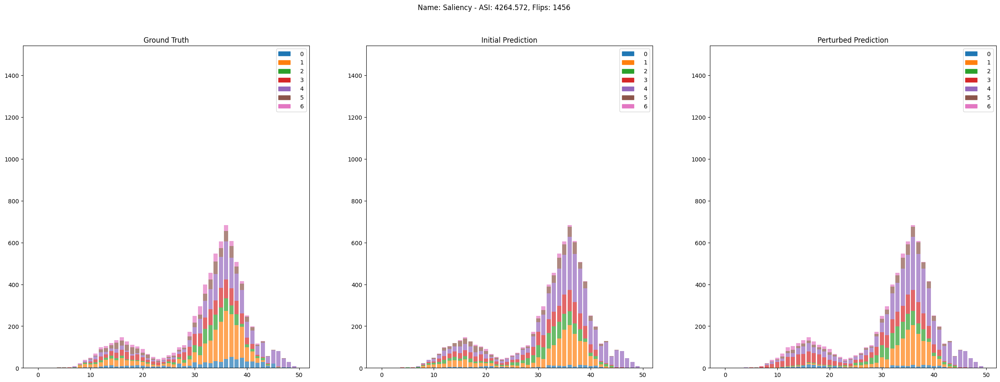

Name: GradientShap
ASI: 3462.837, Flips: 2894, Accuracy before 0.7242, after 0.4793


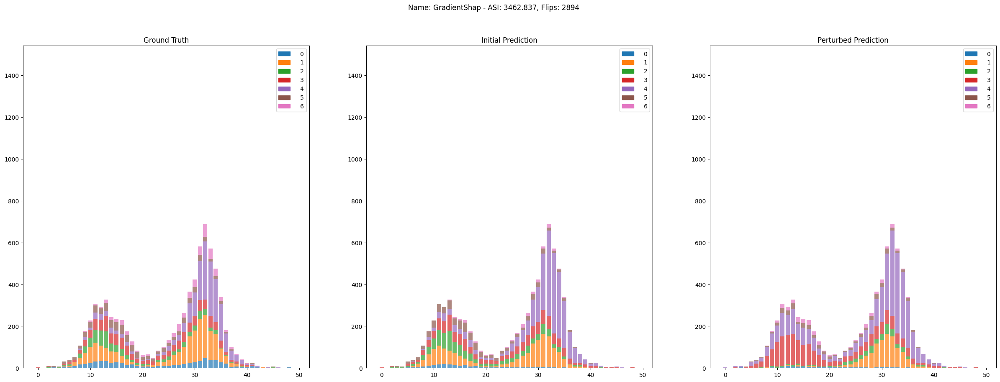

Name: DeepLift
ASI: 3550.267, Flips: 3533, Accuracy before 0.7242, after 0.3988


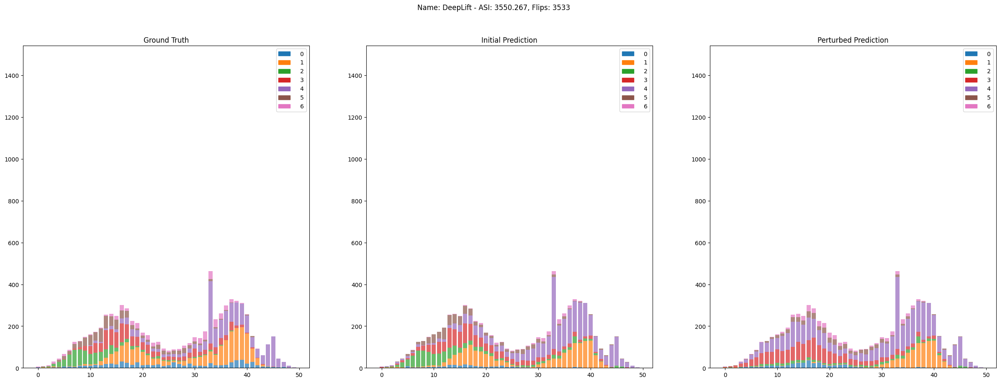

Name: DeepLiftShap
ASI: 3705.841, Flips: 3312, Accuracy before 0.7242, after 0.4276


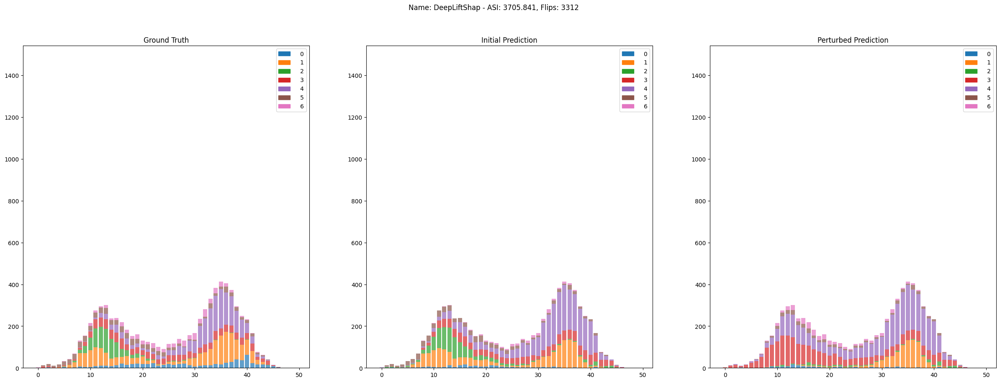

Name: IntegratedGradients
ASI: 3681.176, Flips: 3088, Accuracy before 0.7242, after 0.4088


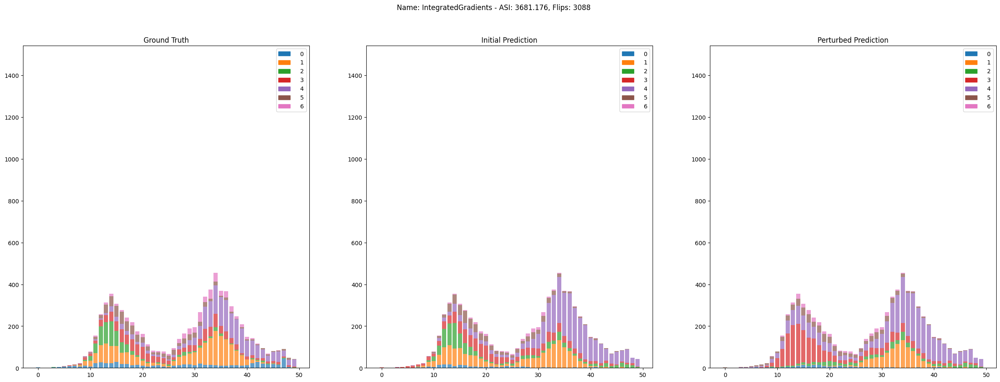

In [42]:
generate_histogram(ret_test_w)

Name: Saliency
ASI: 4264.572, Flips: 1456


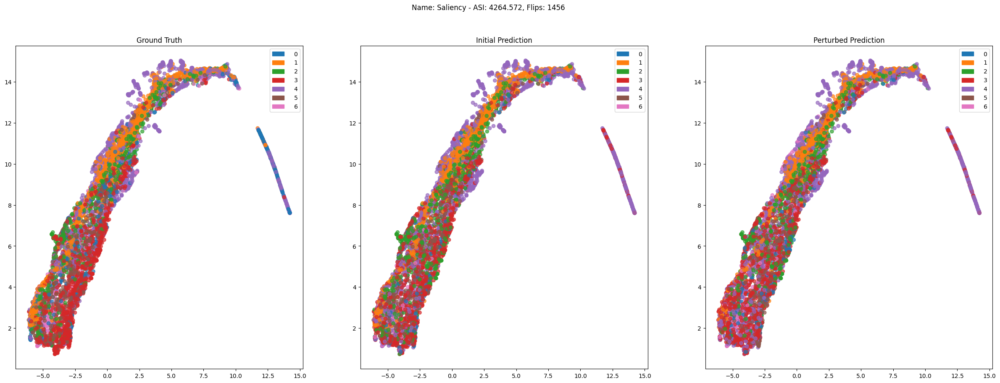

Name: GradientShap
ASI: 3462.837, Flips: 2894


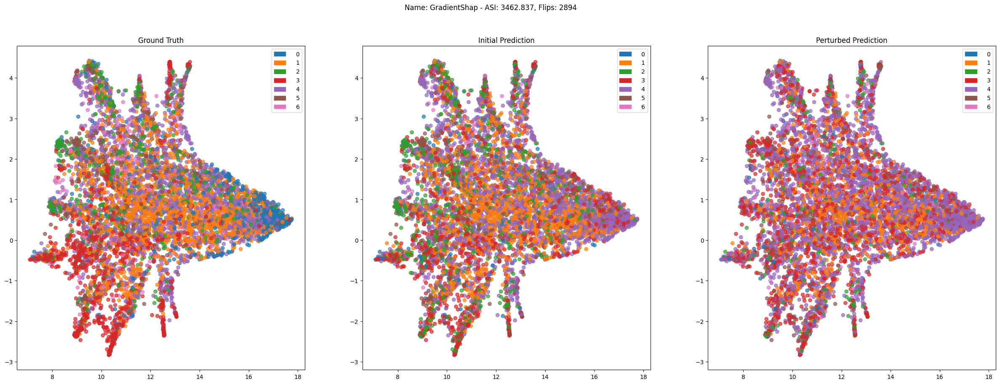

Name: DeepLift
ASI: 3550.267, Flips: 3533


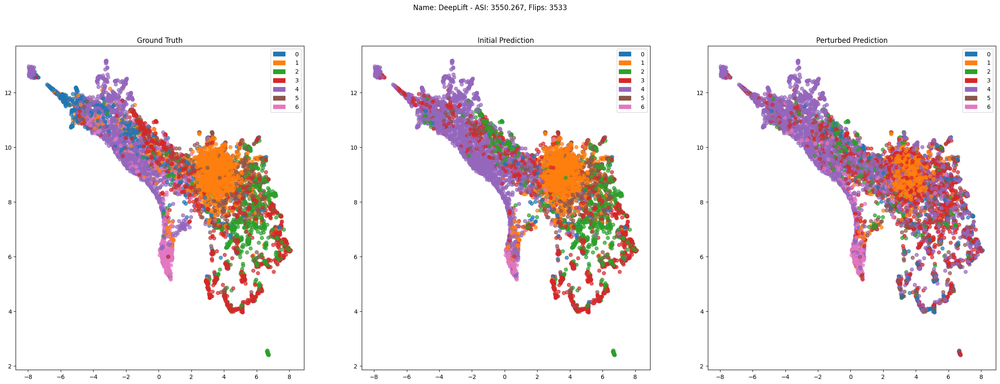

Name: DeepLiftShap
ASI: 3705.841, Flips: 3312


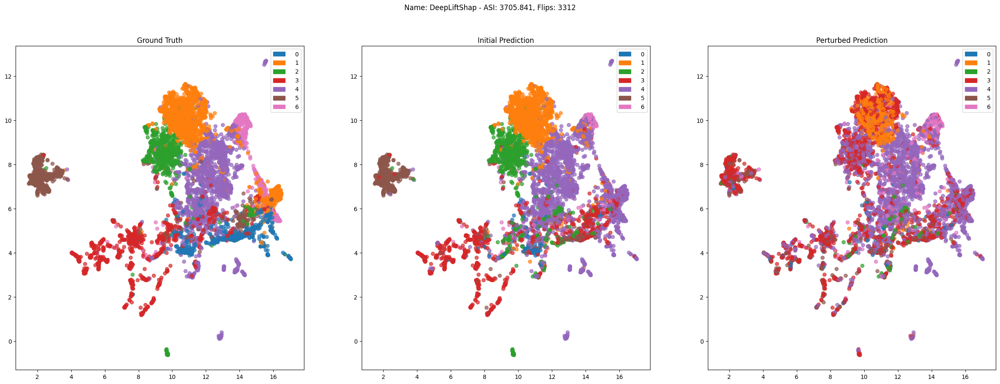

Name: IntegratedGradients
ASI: 3681.176, Flips: 3088


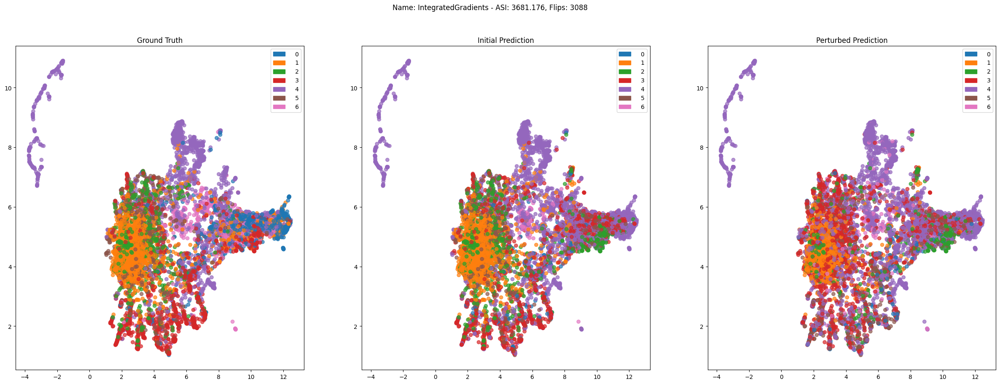

In [43]:
generate_projections(ret_test_w)